### Importer Les librairies qu'on va utiliser

In [2]:
import numpy as np
import pandas as pd
import geopandas as gpd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from sklearn.preprocessing import LabelEncoder
from sklearn.impute import SimpleImputer
from plotly.subplots import make_subplots
import plotly_express as px
import datetime as dt
%matplotlib inline
import warnings
warnings.filterwarnings('ignore')


# I ) L’exploration des données 

## Objectif :


. Comprendre du mieux possible nos données.


. développer une première stratégie de modélisation.

## 1) Analyse de la forme des données

NOTE : la variable de target est "ConfirmedCases"

### La lecture et l'affichage de dataset

In [3]:
data= pd.read_csv("Desktop/mini projetSAD/train.csv")
data

,Id,Province_State,Country_Region,Date,ConfirmedCases,Fatalities
0,1,NaN,Afghanistan,2020-01-22,0.0,0.0
1,2,NaN,Afghanistan,2020-01-23,0.0,0.0
2,3,NaN,Afghanistan,2020-01-24,0.0,0.0
3,4,NaN,Afghanistan,2020-01-25,0.0,0.0
4,5,NaN,Afghanistan,2020-01-26,0.0,0.0
...,...,...,...,...,...,...
35990,35991,NaN,Zimbabwe,2020-05-11,36.0,4.0
35991,35992,NaN,Zimbabwe,2020-05-12,36.0,4.0
35992,35993,NaN,Zimbabwe,2020-05-13,37.0,4.0
35993,35994,NaN,Zimbabwe,2020-05-14,37.0,4.0


In [4]:
df=data.copy()

In [5]:
df.head()

,Id,Province_State,Country_Region,Date,ConfirmedCases,Fatalities
0,1,NaN,Afghanistan,2020-01-22,0.0,0.0
1,2,NaN,Afghanistan,2020-01-23,0.0,0.0
2,3,NaN,Afghanistan,2020-01-24,0.0,0.0
3,4,NaN,Afghanistan,2020-01-25,0.0,0.0
4,5,NaN,Afghanistan,2020-01-26,0.0,0.0


### Representation et visualisation  des features


In [6]:
df.shape

(35995, 6)

In [7]:
df.columns

Index(['Id', 'Province_State', 'Country_Region', 'Date', 'ConfirmedCases',
       'Fatalities'],
      dtype='object')

In [8]:
df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35995 entries, 0 to 35994
Data columns (total 6 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Id              35995 non-null  int64  
 1   Province_State  15295 non-null  object 
 2   Country_Region  35995 non-null  object 
 3   Date            35995 non-null  object 
 4   ConfirmedCases  35995 non-null  float64
 5   Fatalities      35995 non-null  float64
dtypes: float64(2), int64(1), object(3)
memory usage: 1.6+ MB


### Le type des variables

In [9]:
df.dtypes.value_counts()

object     3
float64    2
int64      1
dtype: int64

<AxesSubplot:ylabel='None'>

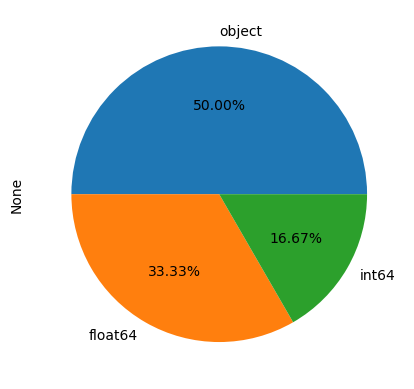

In [10]:
df.dtypes.value_counts().plot.pie(autopct='%.2f%%')

### l'analyse des valeur manquantes

Afficher les variables qui ont un pourcentage des valeurs manquantes superieur que 50%

In [11]:
df.isna().sum()*100/df.shape[0]>50

Id                False
Province_State     True
Country_Region    False
Date              False
ConfirmedCases    False
Fatalities        False
dtype: bool

En a remarquer que la variable ( Province_State ) la seul variable qui le pourcentage des variables manquante superieur que 50%

### visualisation des valeurs manquantes de chaque variable

<AxesSubplot:>

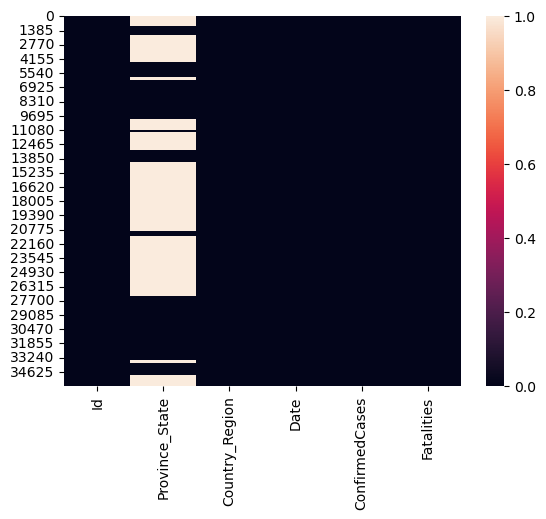

In [12]:
sns.heatmap(df.isna())

 le resultat de methode seaborne: en blanc c'est des valeur manquante et en noir c'est ou il ya des valeur

pourcentage des valeurs manquantes

In [13]:

prct_manquante=data.isna().sum()*100/data.shape[0]
round(prct_manquante.sort_values(),2)

Id                 0.00
Country_Region     0.00
Date               0.00
ConfirmedCases     0.00
Fatalities         0.00
Province_State    57.51
dtype: float64

visualisation du pourcentag des valeurs manquantes

<BarContainer object of 6 artists>

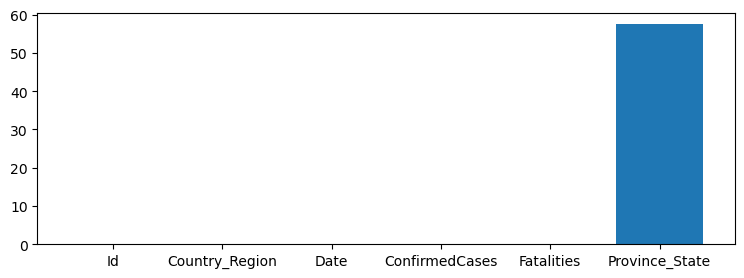

In [14]:

fig=plt.figure(figsize=(9,3))
plt.bar ( x = prct_manquante.sort_values ( ) . index , height = prct_manquante.sort_values ( ) . values )

In [15]:
def missing_zero_values_table(df):
        zero_val = (df == 0.00).astype(int).sum(axis=0)
        mis_val = df.isnull().sum()
        mis_val_percent = 100 * df.isnull().sum() / len(df)
        mz_table = pd.concat([zero_val, mis_val, mis_val_percent], axis=1)
        mz_table = mz_table.rename(
        columns = {0 : 'Zero Values', 1 : 'Missing Values', 2 : '% of Total Values'})
        mz_table['Total Zero Missing Values'] = mz_table['Zero Values'] + mz_table['Missing Values']
        mz_table['% Total Zero Missing Values'] = 100 * mz_table['Total Zero Missing Values'] / len(df)
        mz_table['Data Type'] = df.dtypes
        mz_table = mz_table[
            mz_table.iloc[:,1] != 0].sort_values(
        '% of Total Values', ascending=False).round(1)
        print ("Your selected dataframe has " + str(df.shape[1]) + " columns and " + str(df.shape[0]) + " Rows.\n"      
            "There are " + str(mz_table.shape[0]) +
              " columns that have missing values.")
#         mz_table.to_excel('D:/sampledata/missing_and_zero_values.xlsx', freeze_panes=(1,0), index = False)
        return mz_table

missing_zero_values_table(data)

Your selected dataframe has 6 columns and 35995 Rows.
There are 1 columns that have missing values.


,Zero Values,Missing Values,% of Total Values,Total Zero Missing Values,% Total Zero Missing Values,Data Type
Province_State,0,20700,57.5,20700,57.5,object


En à remarquer que la plupart de nos variables sont complétement non vide et juste une seule variable "Province_State" contient 57% de ces valeurs sont vide.

## 2 ) L'analyse du Fond

### Visualisation initiale - Élimination des colonnes inutiles

Suppression de la colonnes "Id" parceque elle est inutils

In [16]:
df = df.drop('Id', axis=1)

In [17]:
df.head()

,Province_State,Country_Region,Date,ConfirmedCases,Fatalities
0,NaN,Afghanistan,2020-01-22,0.0,0.0
1,NaN,Afghanistan,2020-01-23,0.0,0.0
2,NaN,Afghanistan,2020-01-24,0.0,0.0
3,NaN,Afghanistan,2020-01-25,0.0,0.0
4,NaN,Afghanistan,2020-01-26,0.0,0.0


### Visualisation de target

In [18]:
df.columns[df.isna().sum()*100/df.shape[0]<50]

Index(['Country_Region', 'Date', 'ConfirmedCases', 'Fatalities'], dtype='object')

In [19]:
ConfirmedCases_info=df['ConfirmedCases'].value_counts()/df.shape[0]

In [21]:
#pd.set_option('display.max_rows', None)
#ConfirmedCases_info

### Visualisation de la distribution des variables continue : Histogrames

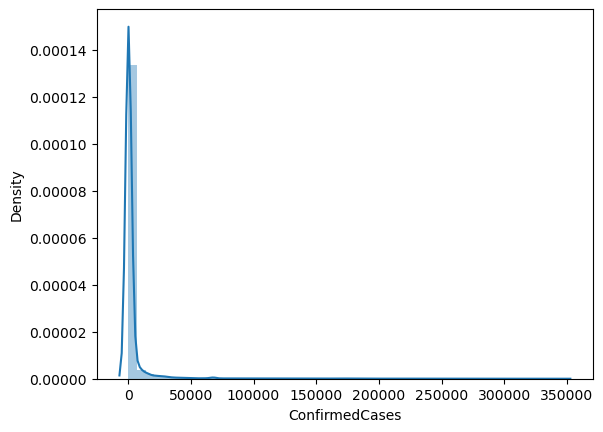

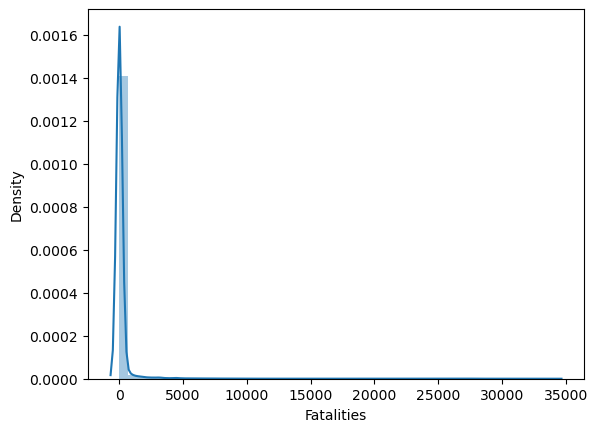

In [22]:
for col in df.select_dtypes('float'):
    plt.figure()
    sns.distplot(df[col])

### présentation des variables Qualitatives

In [23]:
for col in df.select_dtypes('object'):
    
     print(f'{col :-<120}{df[col].unique()}','----> Le nombre de catégories est :',len(df[col].unique()))

Province_State----------------------------------------------------------------------------------------------------------[nan 'Australian Capital Territory' 'New South Wales' 'Northern Territory'
 'Queensland' 'South Australia' 'Tasmania' 'Victoria' 'Western Australia'
 'Alberta' 'British Columbia' 'Manitoba' 'New Brunswick'
 'Newfoundland and Labrador' 'Northwest Territories' 'Nova Scotia'
 'Ontario' 'Prince Edward Island' 'Quebec' 'Saskatchewan' 'Yukon' 'Anhui'
 'Beijing' 'Chongqing' 'Fujian' 'Gansu' 'Guangdong' 'Guangxi' 'Guizhou'
 'Hainan' 'Hebei' 'Heilongjiang' 'Henan' 'Hong Kong' 'Hubei' 'Hunan'
 'Inner Mongolia' 'Jiangsu' 'Jiangxi' 'Jilin' 'Liaoning' 'Macau' 'Ningxia'
 'Qinghai' 'Shaanxi' 'Shandong' 'Shanghai' 'Shanxi' 'Sichuan' 'Tianjin'
 'Tibet' 'Xinjiang' 'Yunnan' 'Zhejiang' 'Faroe Islands' 'Greenland'
 'French Guiana' 'French Polynesia' 'Guadeloupe' 'Martinique' 'Mayotte'
 'New Caledonia' 'Reunion' 'Saint Barthelemy' 'Saint Pierre and Miquelon'
 'St Martin' 'Aruba' 'Bonaire, 

le nombre des catégories de 'Province_State' est : 134

le nombre des catégories de 'Country_Region' est : 184

le nombre des catégories de 'Date' est : 115

### Le nombre d'apparition de chaque catégorie des variables Qualitatives

In [24]:
for col in df.select_dtypes('object'):
    print(f'{col :-<120}{df[col].value_counts()}') 

Province_State----------------------------------------------------------------------------------------------------------Australian Capital Territory        115
Indiana                             115
Nevada                              115
Nebraska                            115
Montana                             115
Missouri                            115
Mississippi                         115
Minnesota                           115
Michigan                            115
Massachusetts                       115
Maryland                            115
Maine                               115
Louisiana                           115
Kentucky                            115
Kansas                              115
Iowa                                115
Illinois                            115
Curacao                             115
Idaho                               115
Hawaii                              115
Guam                                115
Georgia                             115


Le nombre d'appartion de toutes les catégories de la variable 'Province_State' est 115 fois , qui représente le nombre des dates , Donc c'est très biens ca pose pas de problème.

Le nombre d'appartion de toutes les catégories de la variable 'Country_Region' est 115 fois appart (US , China, canada, France , United Kingdom, Australia, Netherlands, Denmark . ca veut dire que dans le dataset ces pays ont des lignes avec la même date (ca peut poser un problème) hna lazm nlamoham hadok bach twali blad wa7da w fi date frida lama kaml al manti9

### Visualisation des variables Quantitatives

<AxesSubplot:xlabel='Province_State', ylabel='Density'>

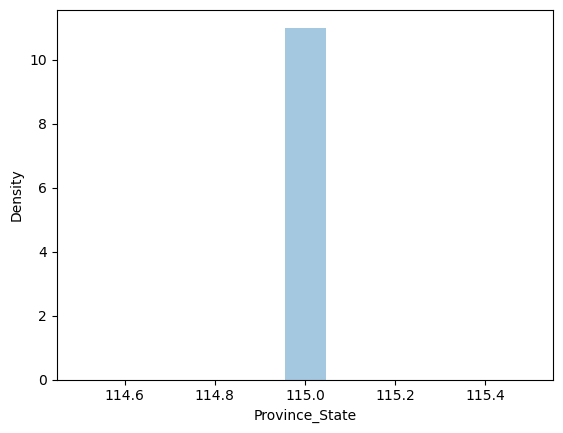

In [25]:
sns.distplot(df['Province_State'].value_counts())

<AxesSubplot:xlabel='Country_Region', ylabel='Density'>

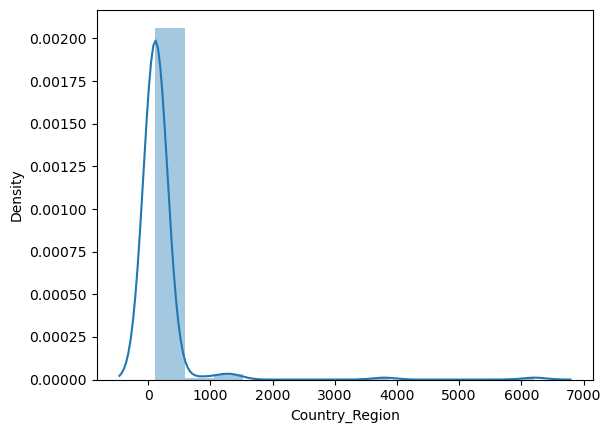

In [26]:
sns.distplot(df['Country_Region'].value_counts())

<AxesSubplot:xlabel='Date', ylabel='Density'>

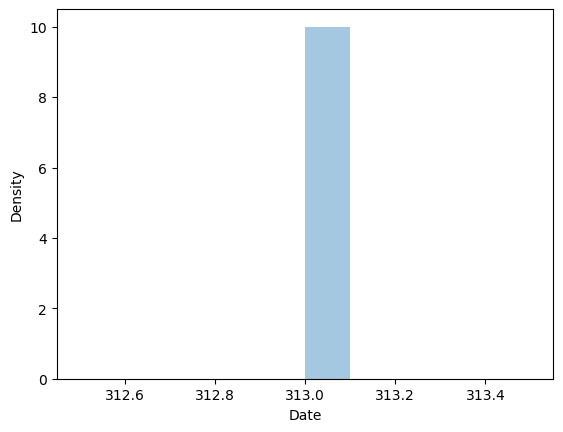

In [27]:
sns.distplot(df['Date'].value_counts())

# Relation Target  / Country_region / Date

In [28]:
dataset=df[['Country_Region','ConfirmedCases']]

In [29]:
def get_ConfirmedCases_by_country(df):
    df_ConfirmedCases_by_country = df.groupby(['Country_Region']).sum()
    return df_ConfirmedCases_by_country

df1=get_ConfirmedCases_by_country(dataset)
df1

,ConfirmedCases
Country_Region,
Afghanistan,87824.0
Albania,30543.0
Algeria,154845.0
Andorra,33193.0
Angola,1254.0
Antigua and Barbuda,1053.0
Argentina,170341.0
Armenia,86278.0
Australia,328080.0


### Les premier cinq pays qui ont le plus grand nombre de ConfirmedCases

In [30]:
df_sorted = df1.sort_values(by='ConfirmedCases', ascending=False)
country_moste_ConfirmedCases=df_sorted.head(5)
country_moste_ConfirmedCases

,ConfirmedCases
Country_Region,
US,39749076.0
Italy,9386990.0
Spain,9322515.0
China,7946795.0
Germany,7080489.0


### Les pays qui ont le nombre totale de ConfirmedCases Zéro 

In [31]:
country_less_ConfirmedCases=df_sorted.tail(5)
country_less_ConfirmedCases

,ConfirmedCases
Country_Region,
Mauritania,411.0
Burundi,406.0
Bhutan,359.0
Papua New Guinea,271.0
Western Sahara,232.0


### visualiser Target (ConfirmedCases) / Country_Region (les cinq premier pays) / Date

on a remarquer que dans les dates de train dataset il ya que le mois 4 et le mois 5 .

# PRE-PROCESSING

In [39]:
data_pro = data.copy()
data.shape

(35995, 6)

## Selection de nos variables dans Train dataset

Élimination de la variable 'Province_State' dans train dataset et Test dataset parceque 57% des valeurs sont manquentes et c'est une cariable catécoriale on peur pas remplire des lignes vides .

In [40]:
data_pro= data_pro[['Country_Region','Date','ConfirmedCases']]
data_pro.shape

(35995, 3)

# Train - Nettoyage - Encodage 

## nettoyer la dataset

Il ya des pays qui ont un nombre de ConfirmedCases différent dans une même date mais dans des 'Province_State' différent . vu que on a éliminer la colonne 'Province_State' il reste des lignes avec la même 'Country_Region' et la même 'Date' mais un nombre de fatalities différent et ça c'est pas logique . Donc en à créer une fonction qui faire la somme des Fatalities dans chaque pays qui apparait dans la dataset dans la même date . 

In [41]:
def get_ConfirmedCases_by_country_Date(df):
    df_ConfirmedCases_by_country_Date = df.groupby(['Country_Region','Date'],as_index=False).sum()
    return df_ConfirmedCases_by_country_Date

clean=get_ConfirmedCases_by_country_Date(data_pro)
clean

,Country_Region,Date,ConfirmedCases
0,Afghanistan,2020-01-22,0.0
1,Afghanistan,2020-01-23,0.0
2,Afghanistan,2020-01-24,0.0
3,Afghanistan,2020-01-25,0.0
4,Afghanistan,2020-01-26,0.0
5,Afghanistan,2020-01-27,0.0
6,Afghanistan,2020-01-28,0.0
7,Afghanistan,2020-01-29,0.0
8,Afghanistan,2020-01-30,0.0
9,Afghanistan,2020-01-31,0.0


In [42]:
clean.shape

(21160, 3)

### La vérification que les pays ( les ctégories de la variable  Country_Region ) apparaitre dans la dataset 115 fois qui représente de nombre des dates qui existe ( le nombre de catégories de la varible Date )

In [43]:
clean['Country_Region'].value_counts()

Afghanistan                         115
Norway                              115
Mozambique                          115
Namibia                             115
Nepal                               115
Netherlands                         115
New Zealand                         115
Nicaragua                           115
Niger                               115
Nigeria                             115
North Macedonia                     115
Oman                                115
Albania                             115
Pakistan                            115
Panama                              115
Papua New Guinea                    115
Paraguay                            115
Peru                                115
Philippines                         115
Poland                              115
Portugal                            115
Qatar                               115
Morocco                             115
Montenegro                          115
Mongolia                            115


In [44]:
len(clean['Country_Region'].unique())


184

Presenter le nombre totale des cas confirmee de chaque pays dans chaque date(the priveist and the most recente).

In [45]:
df_daily = df.groupby(["Date","Country_Region"]).aggregate(
    {'ConfirmedCases': 'sum'})
df_daily

ConfirmedCases
Date       Country_Region                                  
2020-01-22 Afghanistan                                  0.0
           Albania                                      0.0
           Algeria                                      0.0
           Andorra                                      0.0
           Angola                                       0.0
           Antigua and Barbuda                          0.0
           Argentina                                    0.0
           Armenia                                      0.0
           Australia                                    0.0
           Austria                                      0.0
           Azerbaijan                                   0.0
           Bahamas                                      0.0
           Bahrain                                      0.0
           Bangladesh                                   0.0
           Barbados                                     0.0
           Belarus                                      0.0
           Belgium                                      0.0
           Belize                                       0.0
           Benin                                        0.0
           Bhutan                                       0.0
           Bolivia                                      0.0
           Bosnia and Herzegovina                       0.0
           Botswana                                     0.0
           Brazil                                       0.0
           Brunei                                       0.0
           Bulgaria                                     0.0
           Burkina Faso                                 0.0
           Burma                                        0.0
           Burundi                                      0.0
           Cabo Verde                                   0.0
           Cambodia                                     0.0
           Cameroon                                     0.0
           Canada                                       0.0
           Central African Republic                     0.0
           Chad                                         0.0
           Chile                                        0.0
           China                                      548.0
           Colombia                                     0.0
           Congo (Brazzaville)                          0.0
           Congo (Kinshasa)                             0.0
           Costa Rica                                   0.0
           Cote d'Ivoire                                0.0
           Croatia                                      0.0
           Cuba                                         0.0
           Cyprus                                       0.0
           Czechia                                      0.0
           Denmark                                      0.0
           Diamond Princess                             0.0
           Djibouti                                     0.0
           Dominica                                     0.0
           Dominican Republic                           0.0
           Ecuador                                      0.0
           Egypt                                        0.0
           El Salvador                                  0.0
           Equatorial Guinea                            0.0
           Eritrea                                      0.0
           Estonia                                      0.0
           Eswatini                                     0.0
           Ethiopia                                     0.0
           Fiji                                         0.0
           Finland                                      0.0
           France                                       0.0
           Gabon                                        0.0
           Gambia                                       0.0
           Georgia                                      0.0
           Germany       

Obtenir la date la plus récente  Afficher les données pour le jour le plus récent 


In [46]:
most_priveist_date = df['Date'].min()
print(most_priveist_date)

2020-01-22


 Obtenir toutes les données pour la date la plus récente

In [47]:

df_most_priveist = df_daily.loc[most_priveist_date,:]
df_most_priveist

,ConfirmedCases
Country_Region,
Afghanistan,0.0
Albania,0.0
Algeria,0.0
Andorra,0.0
Angola,0.0
Antigua and Barbuda,0.0
Argentina,0.0
Armenia,0.0
Australia,0.0


Obtenir la date la plus récente  Afficher les données pour le jour le plus récent 

In [55]:
most_recent_date = df['Date'].max()
print(most_recent_date)

2020-05-15


Obtenir toutes les données pour la date la plus récente

In [56]:
df_most_recent = df_daily.loc[most_recent_date,:]
df_most_recent

,ConfirmedCases
Country_Region,
Afghanistan,6053.0
Albania,916.0
Algeria,6629.0
Andorra,761.0
Angola,48.0
Antigua and Barbuda,25.0
Argentina,7479.0
Armenia,4044.0
Australia,7035.0


In [57]:
fig=px.pie(df, values='ConfirmedCases', names= 'Country_Region')
fig.update_traces(textposition='inside') 
fig.update_layout(uniformtext_minsize=12,uniformtext_mode='hide')
fig.show()

## Encodage

### Encodage de la variable " Country_Region " dans la Train et Test dataset

In [51]:
label_encoder = LabelEncoder()

In [52]:
clean["Country_Region"] = label_encoder.fit_transform(clean["Country_Region"])


In [53]:
clean

,Country_Region,Date,ConfirmedCases
0,0,2020-01-22,0.0
1,0,2020-01-23,0.0
2,0,2020-01-24,0.0
3,0,2020-01-25,0.0
4,0,2020-01-26,0.0
5,0,2020-01-27,0.0
6,0,2020-01-28,0.0
7,0,2020-01-29,0.0
8,0,2020-01-30,0.0
9,0,2020-01-31,0.0


In [58]:
clean.dtypes

Country_Region      int32
Date               object
ConfirmedCases    float64
dtype: object

### Transformation le type Object de la variable "Date" à "datetime" dans la Train et Test dataset 

In [59]:
clean["Date"] =  pd.to_datetime(clean["Date"], format="%Y/%m/%d")

In [60]:
clean.dtypes

Country_Region             int32
Date              datetime64[ns]
ConfirmedCases           float64
dtype: object

In [61]:
clean.head()

,Country_Region,Date,ConfirmedCases
0,0,2020-01-22,0.0
1,0,2020-01-23,0.0
2,0,2020-01-24,0.0
3,0,2020-01-25,0.0
4,0,2020-01-26,0.0


###  Encodage de la variable " Date " dans train dataset 

In [63]:
avg, dev = clean['Date'].mean(), clean['Date'].std()


In [64]:
date_Train = (clean['Date'] - avg) / dev


In [65]:
date_Train

0       -1.717014
1       -1.686891
2       -1.656768
3       -1.626645
4       -1.596522
5       -1.566399
6       -1.536276
7       -1.506152
8       -1.476029
9       -1.445906
10      -1.415783
11      -1.385660
12      -1.355537
13      -1.325414
14      -1.295291
15      -1.265168
16      -1.235045
17      -1.204922
18      -1.174799
19      -1.144676
20      -1.114553
21      -1.084430
22      -1.054307
23      -1.024184
24      -0.994061
25      -0.963938
26      -0.933815
27      -0.903691
28      -0.873568
29      -0.843445
30      -0.813322
31      -0.783199
32      -0.753076
33      -0.722953
34      -0.692830
35      -0.662707
36      -0.632584
37      -0.602461
38      -0.572338
39      -0.542215
40      -0.512092
41      -0.481969
42      -0.451846
43      -0.421723
44      -0.391600
45      -0.361477
46      -0.331354
47      -0.301230
48      -0.271107
49      -0.240984
50      -0.210861
51      -0.180738
52      -0.150615
53      -0.120492
54      -0.090369
55      -0

In [66]:
date_Train.count()

21160

### supréssion le la colonne date non normalisé et la concaténation de Train dataset avec la colonne date normalisé

In [67]:
clean= clean.drop('Date', axis=1)
clean=(pd.concat([clean,date_Train], axis = 1))
clean

,Country_Region,ConfirmedCases,Date
0,0,0.0,-1.717014
1,0,0.0,-1.686891
2,0,0.0,-1.656768
3,0,0.0,-1.626645
4,0,0.0,-1.596522
5,0,0.0,-1.566399
6,0,0.0,-1.536276
7,0,0.0,-1.506152
8,0,0.0,-1.476029
9,0,0.0,-1.445906


In [68]:
clean.dtypes

Country_Region      int32
ConfirmedCases    float64
Date              float64
dtype: object

Donc voila c bn notre Train data set est Clean et Normalisé

### 3-Model

In [82]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
from sklearn.metrics import explained_variance_score
from sklearn.metrics import mean_absolute_error
from sklearn.ensemble import RandomForestRegressor

In [83]:

X=clean.drop(columns=['ConfirmedCases'])
Y=clean['ConfirmedCases']
X_train, X_test,Y_train,Y_test=train_test_split(X,Y, test_size=0.2)

In [84]:
# Initialisation du modele
model = RandomForestRegressor(n_estimators=300, random_state=0)

In [85]:
# Entrainement du modele
model.fit(X_train, Y_train)

RandomForestRegressor(n_estimators=300, random_state=0)

In [86]:
# Prediction sur le jeu de test
y_pred = model.predict(X_test)


In [87]:
# Evaluation du modele

print("R2 score : ",r2_score(Y_test, y_pred))
print("Mean squared error : ",mean_squared_error(Y_test, y_pred)%1)
print("Mean absolute error : ", mean_absolute_error(Y_test, y_pred)%1)

R2 score :  0.9993430001653698
Mean squared error :  0.0358166613150388
Mean absolute error :  0.5774448645242956


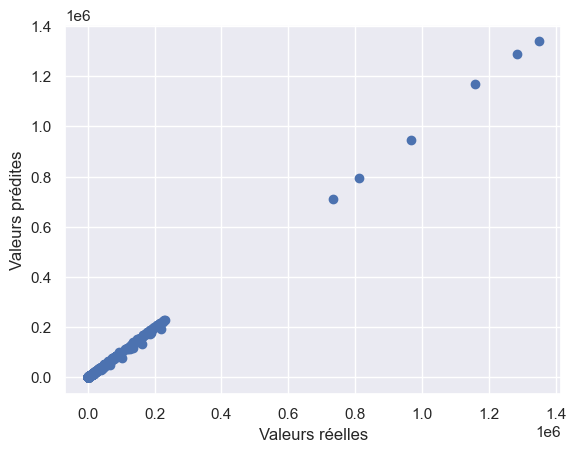

In [88]:
# Visualisation des resultats


plt.scatter(Y_test,y_pred)


plt.xlabel("Valeurs réelles")
plt.ylabel("Valeurs prédites")
plt.show()

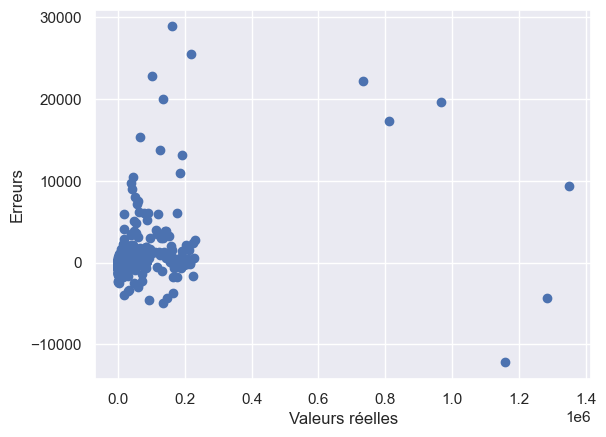

In [89]:
# Visualisation des erreurs
plt.scatter(Y_test, Y_test - y_pred)
plt.xlabel("Valeurs réelles")
plt.ylabel("Erreurs")
plt.show()

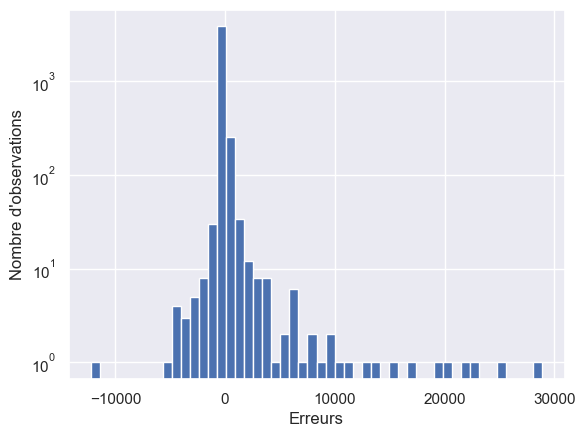

In [90]:
# Visualisation des erreurs
plt.hist(Y_test - y_pred, bins=50)
plt.xlabel("Erreurs")
plt.ylabel("Nombre d'observations")
plt.yscale("log")
plt.show()